# Hw3 - Part 1
Done in google colab!!!

|Name     |Campus Email| ID  |
|---------|--------------------------------|----------|
|Oren Elmakis| oren.elmakis@campus.technion.ac.il|311265516|
|Alon spinner| alonspinner@campus.technion.ac.il| 305184335|

# Imports

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

import os
import glob

import cv2
from PIL import Image

import skimage
from skimage import segmentation
from skimage import color
from skimage.io import imsave
from skimage.future import graph

# from google.colab import drive

import torch
import torchvision
import torchvision.transforms as transforms

In [2]:
# drive.mount('/content/gdrive')
RelPath=".\\"  #has to have at least a '.'

# Q1 
Load the images in the ./data/frogs and ./data/horses folders and display them.

In [3]:
def ImageImport(img_dir):
    images = []  
    
    data_path_jpg=os.path.join(img_dir,'*.jpg')
    data_path_png=os.path.join(img_dir,'*.png')
    GrabbedImageNames=glob.glob(data_path_jpg)+glob.glob(data_path_png)
    
    for ImgName in GrabbedImageNames:
        ImgFile = Image.open(ImgName)
        images.append(ImgFile)
    return images

def PlotImages(images):
    fig,axes = plt.subplots(1,len(images),figsize = (16,2.5))
    for idx,image in enumerate(images):
        axes[idx].imshow(image)
        axes[idx].set_title("Picture Shape: {}".format(np.shape(image)))

def SaveImages(images,names,dirname):
  dirpath=RelPath+'/output/'+dirname
  if not os.path.exists(dirpath):
    os.makedirs(dirpath)    
    print("Directory " , dirname ,  " Created ")

  for image,name in zip(images,names):
    if type(image) is not np.ndarray:
      image=np.array(image)
    filename=RelPath+'/output/'+dirname+'/'+name+'.jpg'
    imsave(filename,image)

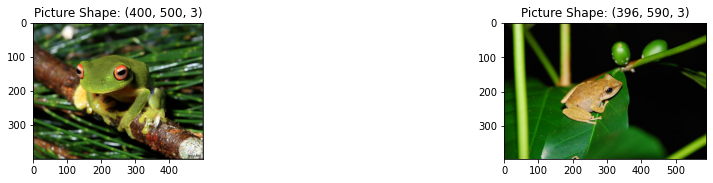

In [4]:
FrogImages=ImageImport(RelPath+'/data/frogs')
PlotImages(FrogImages)

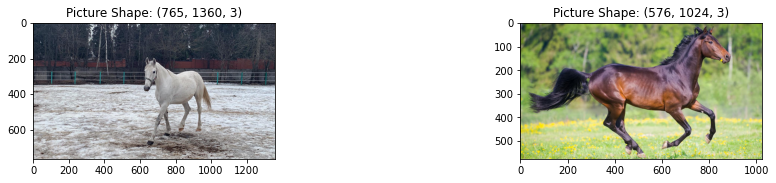

In [7]:
HorseImages= ImageImport(RelPath+'/data/horses')
PlotImages(HorseImages)

# Q2
Pick 1 classic method for segmentation and 1 deep learning-based method and segment the given images. Display the results. Brieﬂy summarize each method you picked and discuss the advantages and disadvantages of each method. In your answer, relate to the results you received in this section. Note: the classic method must not use any neural network.

## Q2 Classic Segmentation:

### Functions

In [8]:
def grabCutSimple(image):
  #image is np
  #https://docs.opencv.org/3.4/d8/d83/tutorial_py_grabcut.html
  
  mask = np.zeros(image.shape[:2],np.uint8)
  bgdModel = np.zeros((1,65),np.float64)
  fgdModel = np.zeros((1,65),np.float64)

  rows=image.shape[0]
  cols=image.shape[1]
  R=int(rows/8)
  C=int(cols/8)
  rect = (C,R,cols-C,rows-R) #x,y,h,w
  
  cv2.grabCut(image,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
  mask2 = np.where((mask==2)|(mask==0),0,1).astype('uint8')

  maskedimage = image*mask2[:,:,np.newaxis]
  out = cv2.rectangle(maskedimage,(C,R),(cols-C,rows-R),(255,0,0),3)
  return out

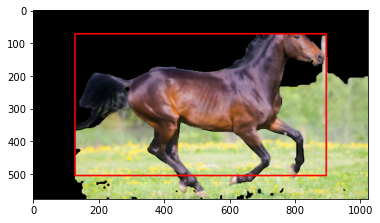

In [9]:
grabcutcheck=cv2.GaussianBlur(np.array(HorseImages[1]),(5,5),cv2.BORDER_DEFAULT)
grabcutcheck=grabCutSimple(grabcutcheck)
plt.imshow(grabcutcheck)

In [21]:
def Calculate_Classic_Segmentations(images, fz_scale=1000, fz_sigma=0.5 ,fz_min_size=200,
                                    slic_n_segments=200, slic_compactness=10, slic_sigma=1,
                                    qs_kernel_size=7, qs_max_dist=200, qs_ratio=0.3,
                                    ws_markers=250, ws_compactness=0.001):
    #highly based on
    #https://scikit-image.org/docs/dev/api/skimage.segmentation.html
    #https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_segmentations.html
    
    Psegs = []
    for image in images:
        image=np.array(image)

        segments_fz = segmentation.felzenszwalb(image, scale=fz_scale, sigma=fz_sigma, min_size=fz_min_size) #scale - higher means larger culsters
        segments_slic = segmentation.slic(image, n_segments=slic_n_segments, compactness=slic_compactness, sigma=slic_sigma) #higher compactness - more value to space
        segments_quick = segmentation.quickshift(image, kernel_size=qs_kernel_size, max_dist=qs_max_dist, ratio=qs_ratio) #ratio - more weight to color, higher max_dist means fewer culsters

        gradient = skimage.filters.sobel(color.rgb2gray(image))
        segments_watershed = segmentation.watershed(gradient, markers=ws_markers, compactness=ws_compactness) #higher compactness means more regular shapes

        segs=(segments_fz,segments_slic,segments_quick,segments_watershed)
        Psegs.append(segs)

        #Psegs (plural segs) is a tuple where each element contains another tuple of 4 segmentations 
    return Psegs

In [22]:
def Calculate_Classic_Segmentations_AVG(images,Psegs):
  PAVGs=[]
  for image,segs in zip(images,Psegs): 
    image=np.array(image)
    AVGs=[]
    for seg in segs:
      AVGs.append(color.label2rgb(seg, image, kind='avg', bg_label=0))
    
    PAVGs.append(AVGs)
  
  #PAVGs (plural AVGs) is a tuple where each element contains another tuple of 4 averages of segmentations 
  return PAVGs

In [23]:
def Calculate_Classic_Segmentations_NCuts(images,Psegs):
  #https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_ncut.html
  P_NCut_segs=[]
  for image,segs in zip(images,Psegs): 
    image=np.array(image)
    NCut_segs=[]
    for seg in segs:
      print('Cut Established')
      g = graph.rag_mean_color(image, seg, mode='similarity')
      new_seg = graph.cut_normalized(seg, g)
      NCut_segs.append(new_seg)

    P_NCut_segs.append(NCut_segs)
    #P_NCut_segs (plural) is a tuple where each element contains another tuple of 4 averages of NCuted segmentations
  return P_NCut_segs

In [24]:
def Plot_ClassicSegs(image,segs):
    segments_fz=segs[0]
    segments_slic=segs[1]
    segments_quick=segs[2]
    segments_watershed=segs[3]
    
    fig, ax = plt.subplots(1, 4, figsize=(30, 5), sharex=True, sharey=True)
    ax[0].imshow(segmentation.mark_boundaries(image, segments_fz))
    ax[0].set_title("Felzenszwalbs's method\n{} segments".format(len(np.unique(segments_fz))))
    ax[1].imshow(segmentation.mark_boundaries(image, segments_slic))
    ax[1].set_title('SLIC\n{} segments'.format(len(np.unique(segments_slic))))
    ax[2].imshow(segmentation.mark_boundaries(image, segments_quick))
    ax[2].set_title('Quickshift\n{} segments'.format(len(np.unique(segments_quick))))
    ax[3].imshow(segmentation.mark_boundaries(image, segments_watershed))
    ax[3].set_title('Compact watershed\n{} segments'.format(len(np.unique(segments_watershed))))
    for a in ax.ravel():
      a.set_axis_off()

In [25]:
def Plot_ClassicSegs_AVG(image_AVGs):
    fig, ax = plt.subplots(1, 4, figsize=(30, 5), sharex=True, sharey=True)
    ax[0].imshow(image_AVGs[0])
    ax[1].imshow(image_AVGs[1])
    ax[2].imshow(image_AVGs[2])
    ax[3].imshow(image_AVGs[3])
    for a in ax.ravel():
      a.set_axis_off()

In [26]:
def Plot_ClassicSegs_and_AVG(images,Psegs,PsegsAVGs,PNCutSegs,PNCutSegsAVGs):
    for image,segs,segsAVGs,NCutSegs,NCutSegsAVGs in zip(images,Psegs,PsegsAVGs,PNCutSegs,PNCutSegsAVGs):
      Plot_ClassicSegs(image,segs)
      Plot_ClassicSegs_AVG(segsAVGs)
      Plot_ClassicSegs(image,NCutSegs)
      Plot_ClassicSegs_AVG(NCutSegsAVGs)

### Results:

C:\Users\orene\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  


Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established


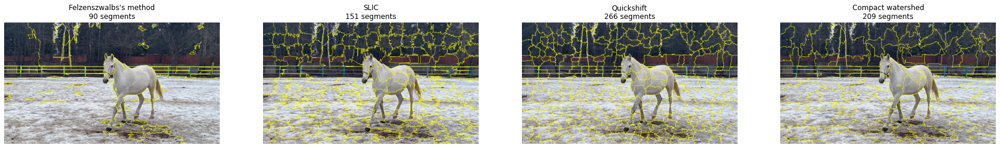

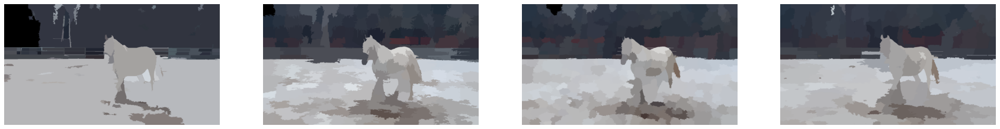

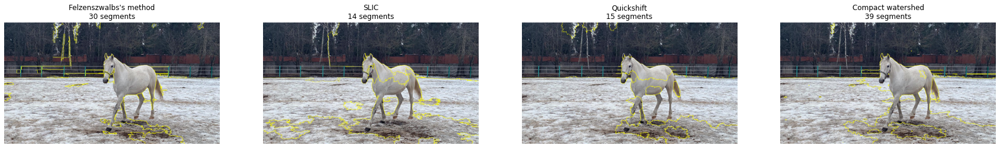

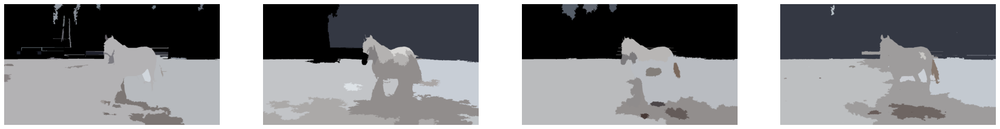

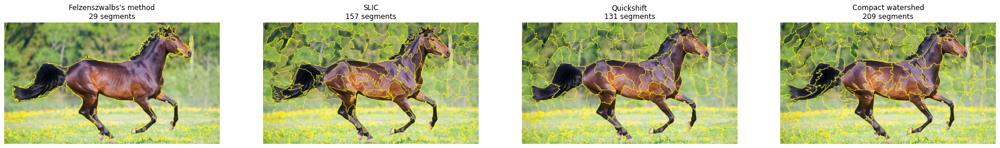

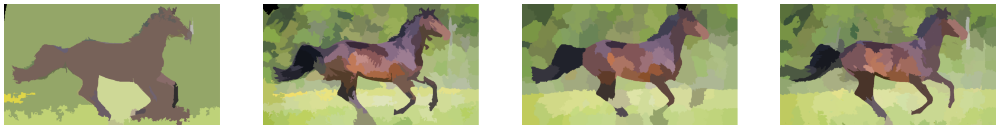

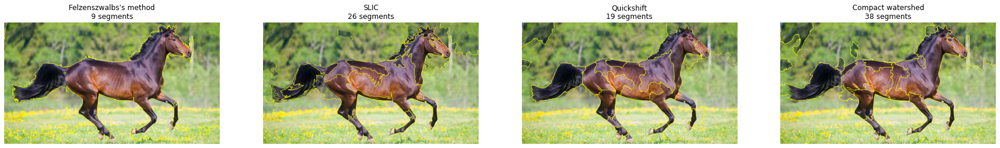

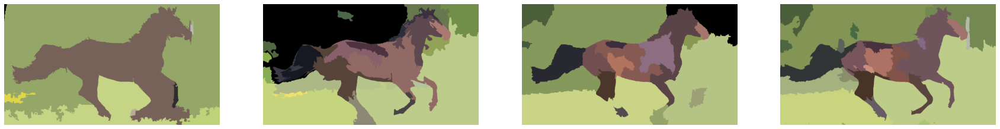

In [14]:
HorseClassicSegs=Calculate_Classic_Segmentations(HorseImages, fz_scale=1000, fz_sigma=0.5 ,fz_min_size=400,
                                    slic_n_segments=200, slic_compactness=10, slic_sigma=1,
                                    qs_kernel_size=7, qs_max_dist=300, qs_ratio=0.3,
                                    ws_markers=200, ws_compactness=0.0001)
FrogClassicSegs_AVG=Calculate_Classic_Segmentations_AVG(HorseImages,HorseClassicSegs)
HorseClassicSegs_NCuts=Calculate_Classic_Segmentations_NCuts(HorseImages,HorseClassicSegs)
HorseClassicSegs_NCuts_AVG=Calculate_Classic_Segmentations_AVG(HorseImages,HorseClassicSegs_NCuts)

Plot_ClassicSegs_and_AVG(HorseImages,HorseClassicSegs,FrogClassicSegs_AVG,HorseClassicSegs_NCuts,HorseClassicSegs_NCuts_AVG)

C:\Users\orene\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  


Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established


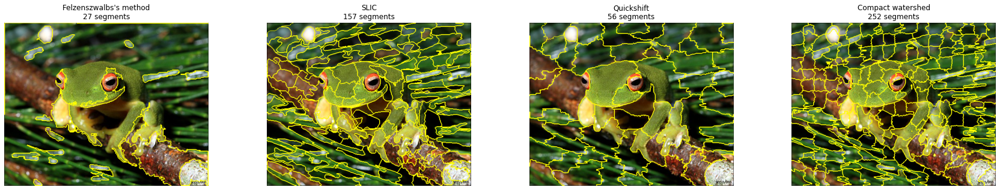

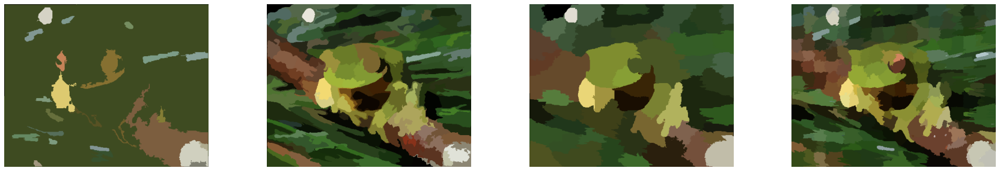

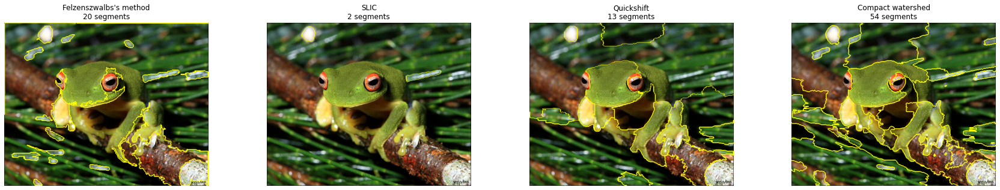

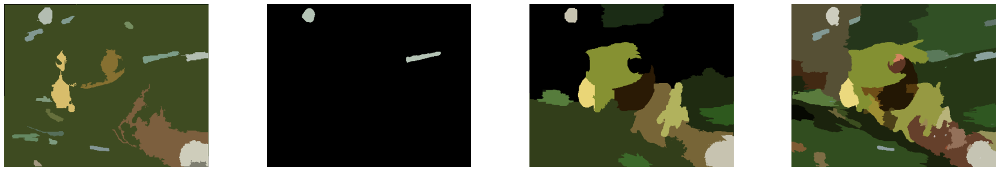

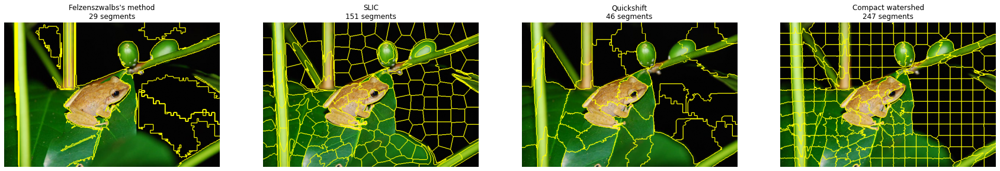

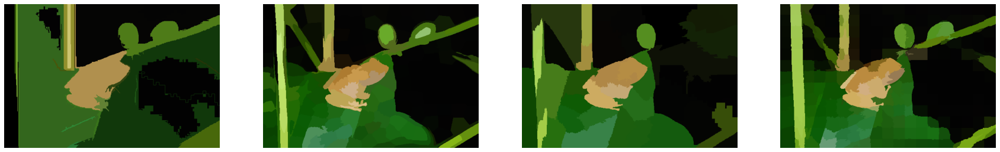

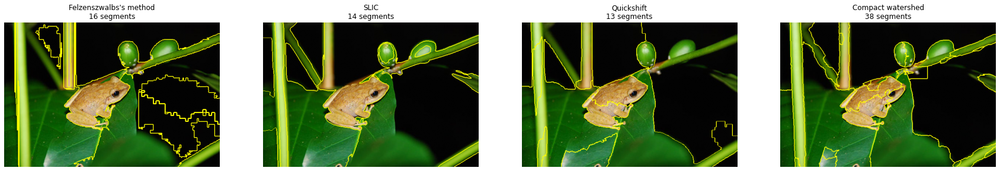

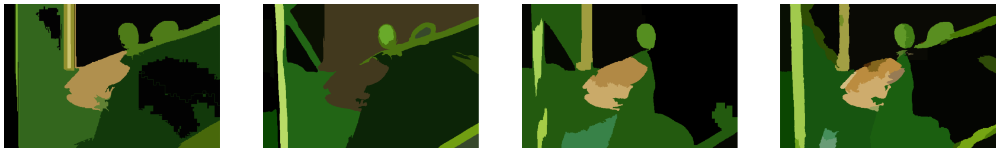

In [15]:
FrogClassicSegs=Calculate_Classic_Segmentations(FrogImages)

FrogClassicSegs_NCuts=Calculate_Classic_Segmentations_NCuts(FrogImages,FrogClassicSegs)
FrogClassicSegs_AVG=Calculate_Classic_Segmentations_AVG(FrogImages,FrogClassicSegs)
FrogClassicSegs_NCutsAVG=Calculate_Classic_Segmentations_AVG(FrogImages,FrogClassicSegs_NCuts)

Plot_ClassicSegs_and_AVG(FrogImages,FrogClassicSegs,FrogClassicSegs_AVG,FrogClassicSegs_NCuts,FrogClassicSegs_NCutsAVG)

[  1   4   7  13  24  36  39  62  82  85  86  87  88  89  91  99 101 104
 109 128 129 131 133 137 138 148 155 163 166 167 169 170 171 176 178 181
 191 192 193 198 210 211 213 214 216 217 224 228 230 232 233 237 248 251]


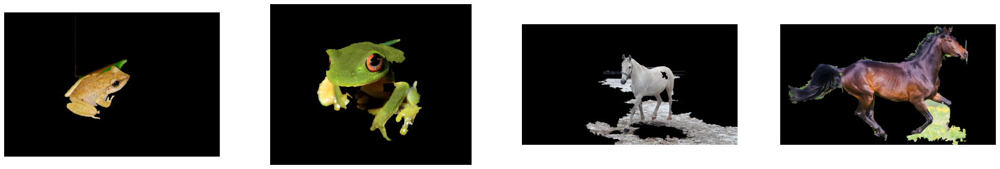

In [16]:
FrogImagesnp1 = np.array(FrogImages[1])
vv  = np.unique(FrogClassicSegs_NCuts[1][0])
v = (FrogClassicSegs_NCuts[1][0] != 11)
index = np.where(v)
FrogImagesnp1[v] = 0
FrogImagesnp2 = np.array(FrogImages[0])
vv  = np.unique(FrogClassicSegs_NCuts[0][3])
print(vv)
v = (FrogClassicSegs_NCuts[0][3] == 62)
v += (FrogClassicSegs_NCuts[0][3] == 99)
v += (FrogClassicSegs_NCuts[0][3] == 101)
v += (FrogClassicSegs_NCuts[0][3] == 131)
v += (FrogClassicSegs_NCuts[0][3] == 138)
v = ~v
FrogImagesnp2[v] = 0
HorseImagesnp1 = np.array(HorseImages[0])
vv  = np.unique(HorseClassicSegs_NCuts[0][3])
v = (HorseClassicSegs_NCuts[0][3] != 67)
HorseImagesnp1[v] = 0
HorseImagesnp2 = np.array(HorseImages[1])
vv  = np.unique(HorseClassicSegs_NCuts[1][0])
v = (HorseClassicSegs_NCuts[1][0] != 2)
HorseImagesnp2[v] = 0
fig, ax = plt.subplots(1, 4, figsize=(30, 5))
ax[0].imshow(FrogImagesnp1)
ax[1].imshow(FrogImagesnp2)
ax[2].imshow(HorseImagesnp1)
ax[3].imshow(HorseImagesnp2)
for a in ax.ravel():
  a.set_axis_off()

## Q2 Deep segmentation

### Init. and Functions

In [15]:
# download and load the pre-trained model
model = torch.hub.load('pytorch/vision:v0.5.0', 'deeplabv3_resnet101', pretrained=True)
# put in inference mode
model.eval();

# define device and adjust model
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

Downloading: "https://github.com/pytorch/vision/archive/v0.5.0.zip" to C:\Users\alons/.cache\torch\hub\v0.5.0.zip
Downloading: "https://download.pytorch.org/models/resnet101-5d3b4d8f.pth" to C:\Users\alons/.cache\torch\checkpoints\resnet101-5d3b4d8f.pth
100.0%
Downloading: "https://download.pytorch.org/models/deeplabv3_resnet101_coco-586e9e4e.pth" to C:\Users\alons/.cache\torch\checkpoints\deeplabv3_resnet101_coco-586e9e4e.pth
100.0%


In [16]:
deeplabv3_labels = ['background','aeroplane',  'bicycle', 'bird',  'boat',      'bottle', 
          'bus',        'car',      'cat',  'chair',     'cow',
          'diningtable','dog',    'horse',  'motorbike', 'person',
          'pottedplant','sheep',  'sofa',   'train',   'tvmonitor']
print(["{}: {}".format(i , deeplabv3_labels[i]) for i in range(len(deeplabv3_labels))])

['0: background', '1: aeroplane', '2: bicycle', '3: bird', '4: boat', '5: bottle', '6: bus', '7: car', '8: cat', '9: chair', '10: cow', '11: diningtable', '12: dog', '13: horse', '14: motorbike', '15: person', '16: pottedplant', '17: sheep', '18: sofa', '19: train', '20: tvmonitor']


* All pre-trained models expect input images normalized in the same way, i.e. 
mini-batches of 3-channel RGB images of shape $(N, 3, H, W)$, where $N$ is the number of images, $H$ and $W$ are expected to be at least 224 pixels.

* The images have to be loaded in to a range of $[0, 1]$ and then normalized using mean = $[0.485, 0.456, 0.406]$ and std = $[0.229, 0.224, 0.225]$.

* The model returns an OrderedDict with two Tensors that are of the same height and width as the input Tensor, but with 21 classes.

* output['out'] contains the semantic masks, and output['aux'] contains the auxillary loss values per-pixel.

* In inference mode, output['aux'] is not useful. So, output['out'] is of shape $(N, 21, H, W)$.

In [17]:
def PassForward2deeplabv3(raw_images,images):
    preprocess = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
  ])

    # create a color pallette, selecting a color for each class
    palette = torch.tensor([2 ** 25 - 1, 2 ** 15 - 1, 2 ** 21 - 1]) #1x3 
    colors = torch.as_tensor([i for i in range(21)])[:, None] * palette #column vector from 0-20 .* palette
    colors = (colors % 255).numpy().astype("uint8") #21x3 matrix of colors

    images_gallery=[]
    for raw_image,image in zip(raw_images,images):
      #into model
      t_image = preprocess(image).unsqueeze(0).to(device) #unsqueeze makes the size [1,3,W,H]
      with torch.no_grad(): #quicken outputs, dont want to calculate gradients in forward
        output = model(t_image)['out'][0]
      output_predictions = output.argmax(0) #initial output is of size (21,H,W) containing probabilties for each class for each pixel. collapse to (1,H,W)
      output_predictions_np=output_predictions.byte().cpu().numpy()

      #create PIL image with distincant color per class
      seg_image = Image.fromarray(output_predictions_np) #no need to resize.. not sure why here to begin with
      seg_image.putpalette(colors)

      #find most significant class
      # LabelPixelCount=np.bincount(output_predictions_np.ravel())
      # if len(np.unique(LabelPixelCount))>1:
      #   SignifcantLabel=np.argmax(np.delete(LabelPixelCount,0))+1 #remove background and add 1 to corelate to label
      # else:
      #   SignifcantLabel=0

      mask = torch.zeros_like(output_predictions).float().to(device) #matrix filled with zeros
      mask[output_predictions != 0 ] = 1 #bring forth everything that isnt background
      mask=mask.unsqueeze(2).byte().cpu().numpy() #3 channels so product with RGB will work

      #apply mask on image
      masked_image=Image.fromarray(np.array(raw_image) * mask)

      #find participating class labels that arent background
      classlabels=np.unique(output_predictions_np.ravel()).astype(int)
      if len(np.unique(classlabels))>1: #if more than just background
        classlabels=np.delete(classlabels,0) #remove background label

      #create output
      galleryout=(raw_image,image,seg_image,masked_image,classlabels)

      images_gallery.append(galleryout)
    return images_gallery

def plotDeepSegGalleries(images_DeepSegGallery):
  fig, ax = plt.subplots(len(images_DeepSegGallery), 4, figsize=(15, 5),sharex=True, sharey=True)
  
  for i,Gallery in enumerate(images_DeepSegGallery):
    ax[i,0].imshow(Gallery[0]) #raw_image
    ax[i,1].imshow(Gallery[1]) #image
    ax[i,2].imshow(Gallery[2]) #seg
    ax[i,3].imshow(Gallery[3]) #masked image
    
    ax[i,0].set_title('Raw Image')
    ax[i,1].set_title('Image into Segmentor')
    ax[i,2].set_title([deeplabv3_labels[i] for i in Gallery[4]])
  
  for a in ax.ravel():
    a.set_axis_off()

  fig.tight_layout()

### Results

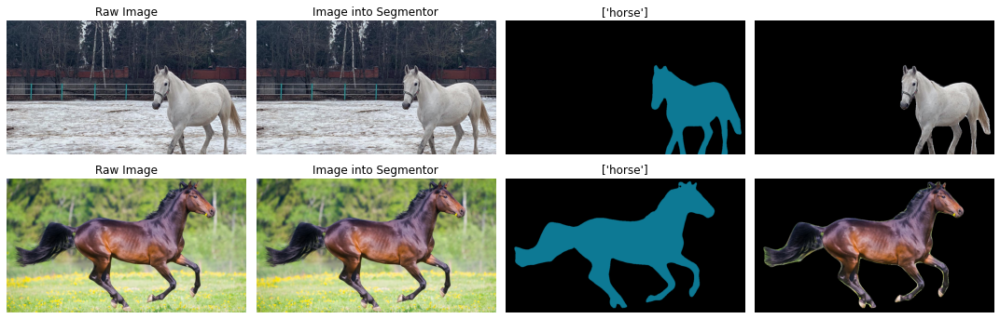

In [28]:
HorseImages_DeepSegGallery=PassForward2deeplabv3(HorseImages,HorseImages)
plotDeepSegGalleries(HorseImages_DeepSegGallery)
#SaveImages(HorseImages_DeepSegGallery[0][1:4],names=['WhiteHorse','WhiteHorse_Seg','WhiteHorse_Mask'],dirname='Q2_Deep')

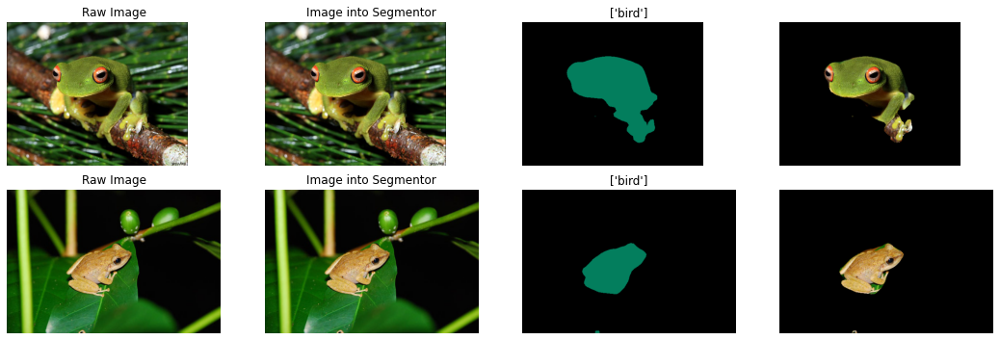

In [29]:
FrogImages_DeepSegGallery=PassForward2deeplabv3(FrogImages,FrogImages)
plotDeepSegGalleries(FrogImages_DeepSegGallery)

# Q3

Pick 3 images (download from the internet or take them yourself) that satisfy the following, and display them: 
* One image of a living being (human, animal,...)
* One image of commonly-used object (car, chair, smartphone, glasses,...).
* One image of not-so-commonly-used object (ﬁre extinguisher, satellite,... BE CREATIVE).

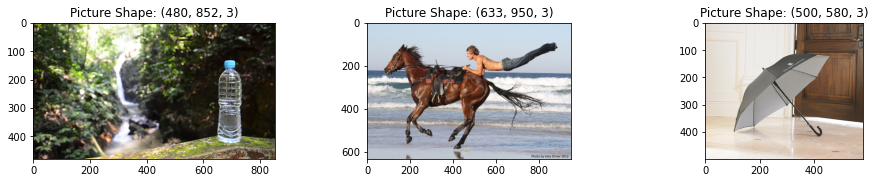

In [18]:
Q3Images=ImageImport(RelPath+'/my_data/Part1Q3')
PlotImages(Q3Images)

# Q4
Apply each method (one classic and one deep learning-based) on the 3 images. Display the results. Which method performed better on each image? Describe your thoughts on why one method is better than the other.

C:\Users\alons\Miniconda2\envs\torch046746\lib\site-packages\ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  


Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established
Cut Established


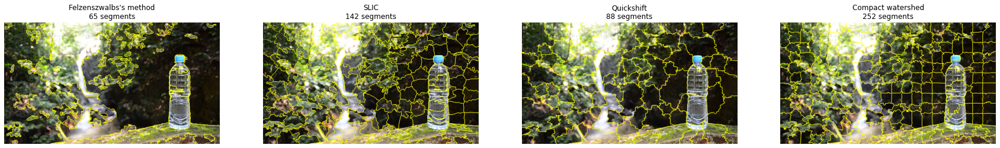

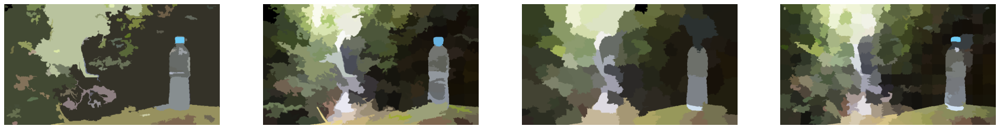

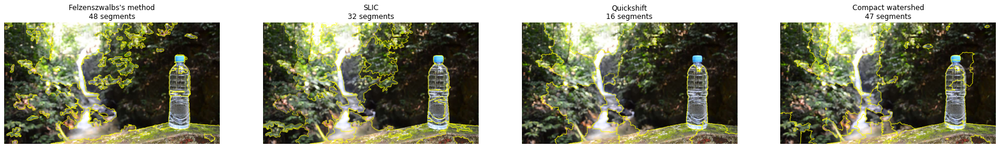

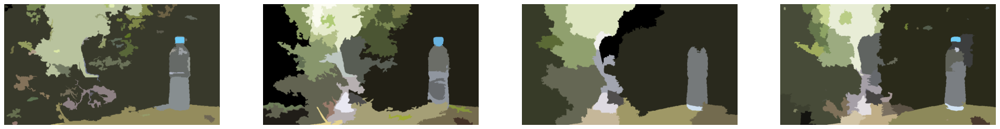

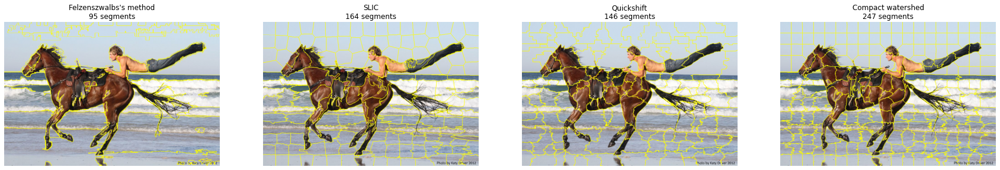

...

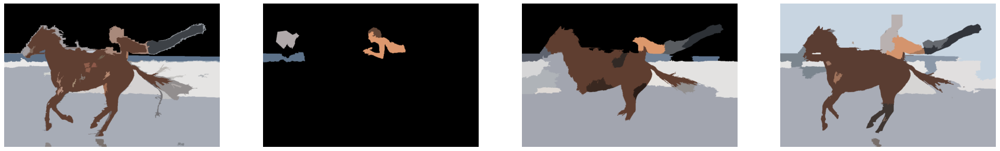

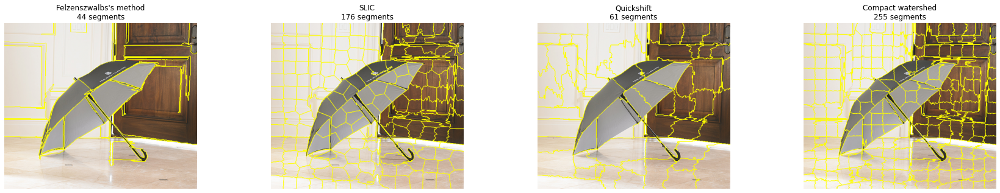

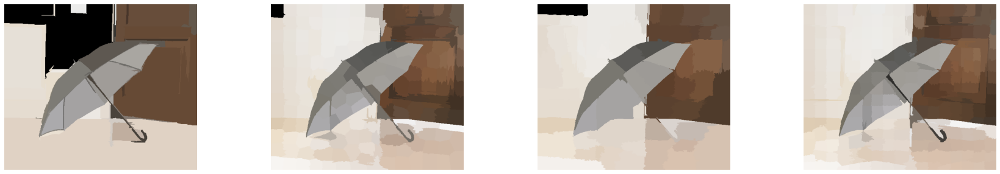

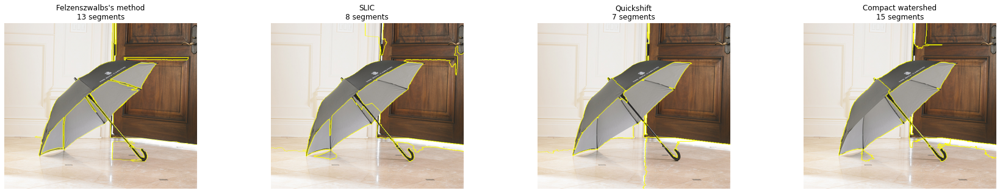

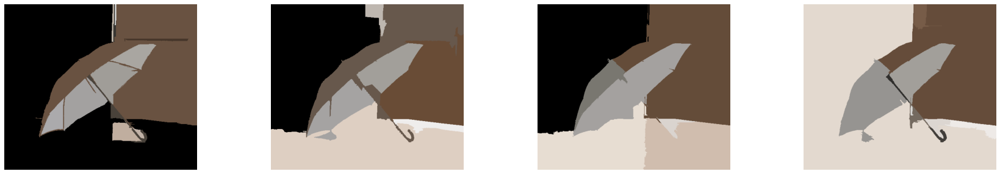

In [27]:
Q3ClassicSegs=Calculate_Classic_Segmentations(Q3Images)
Q3ClassicSegs_AVG=Calculate_Classic_Segmentations_AVG(Q3Images,Q3ClassicSegs)
Q3ClassicSegs_NCuts=Calculate_Classic_Segmentations_NCuts(Q3Images,Q3ClassicSegs)
Q3ClassicSegs_NCuts_AVG=Calculate_Classic_Segmentations_AVG(Q3Images,Q3ClassicSegs_NCuts)

Plot_ClassicSegs_and_AVG(Q3Images,Q3ClassicSegs,Q3ClassicSegs_AVG,Q3ClassicSegs_NCuts,Q3ClassicSegs_NCuts_AVG)

[ 0  3  4  5  6 14 17 21 26 27 33 40 41]


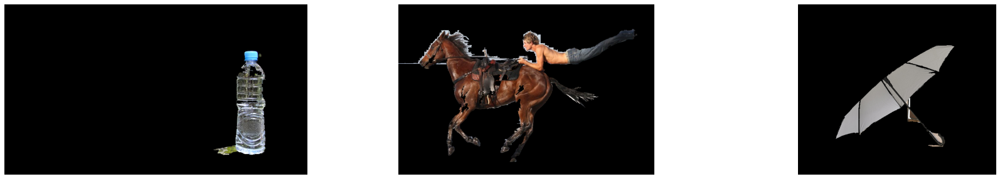

In [28]:
Q3Imagesnp1 = np.array(Q3Images[0])
vv  = np.unique(Q3ClassicSegs_NCuts[0][0])
v = (Q3ClassicSegs_NCuts[0][0] == 25)
v += (Q3ClassicSegs_NCuts[0][0] == 48)
v += (Q3ClassicSegs_NCuts[0][0] == 27)
v = ~v
index = np.where(v)
Q3Imagesnp1[v] = 0
Q3Imagesnp2 = np.array(Q3Images[1])
vv  = np.unique(Q3ClassicSegs_NCuts[1][0])
v = (Q3ClassicSegs_NCuts[1][0] == 20)
v += (Q3ClassicSegs_NCuts[1][0] == 21)
v += (Q3ClassicSegs_NCuts[1][0] == 22)
v += (Q3ClassicSegs_NCuts[1][0] == 23)
v += (Q3ClassicSegs_NCuts[1][0] == 24)
v = ~v
Q3Imagesnp2[v] = 0
Q3Imagesnp3 = np.array(Q3Images[2])
vv  = np.unique(Q3ClassicSegs_NCuts[2][0])
print(vv)
v = (Q3ClassicSegs_NCuts[2][0] == 17)
v += (Q3ClassicSegs_NCuts[2][0] == 21)
v += (Q3ClassicSegs_NCuts[2][0] == 26)
v += (Q3ClassicSegs_NCuts[2][0] == 27)
v += (Q3ClassicSegs_NCuts[2][0] == 33)
v += (Q3ClassicSegs_NCuts[2][0] == 41)
v = ~v
Q3Imagesnp3[v] = 0
fig, ax = plt.subplots(1, 3, figsize=(30, 5))
ax[0].imshow(Q3Imagesnp1)
ax[1].imshow(Q3Imagesnp2)
ax[2].imshow(Q3Imagesnp3)
for a in ax.ravel():
  a.set_axis_off()

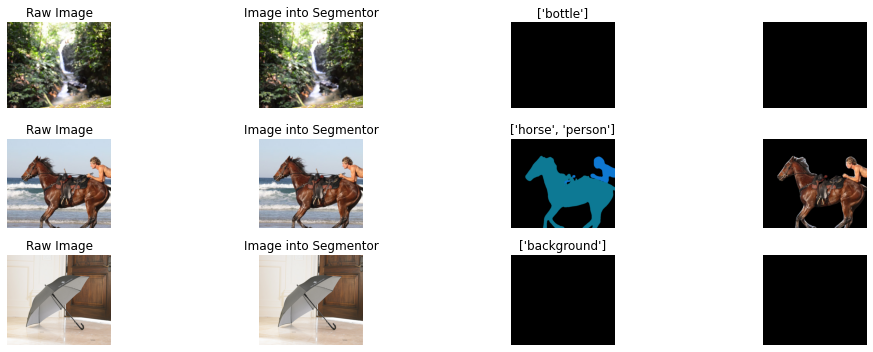

In [29]:
#Deep
Q3Images_DeepSegGallery=PassForward2deeplabv3(Q3Images,Q3Images)
plotDeepSegGalleries(Q3Images_DeepSegGallery)

#Q5
As you probably have noticed, segmentation can be rough around the edges, i.e., the mask is not perfect and may be noisy around the edges. What can be done to ﬁx or at least alleviate this problem? Your suggestions can be in pre-processing, inside the segmentation algorithm or in post-processing.

## Functions

In [30]:
def Plot_ClassicSegs_and_AVG_Q5(images,Psegs,PsegsAVGs):
    for image,segs,segsAVGs in zip(images,Psegs,PsegsAVGs):
      Plot_ClassicSegs(image,segs)
      Plot_ClassicSegs_AVG(segsAVGs)

## Sharpen Image as preprocessing

In [31]:
def sharpenImages(images,radius=5,amount=2):
  #https://scikit-image.org/docs/dev/auto_examples/filters/plot_unsharp_mask.html

  sharp_images=[]
  for image in images:
    sharp=skimage.filters.unsharp_mask(image, radius, amount)
    sharp_images.append(Image.fromarray((sharp*255).astype(np.uint8)))

  return sharp_images

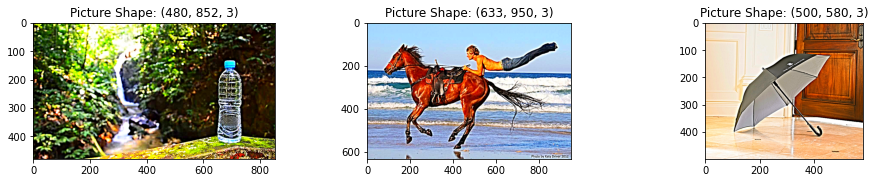

In [32]:
sharpQ3Images=sharpenImages(Q3Images)
PlotImages(sharpQ3Images)

C:\Users\alons\Miniconda2\envs\torch046746\lib\site-packages\ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  


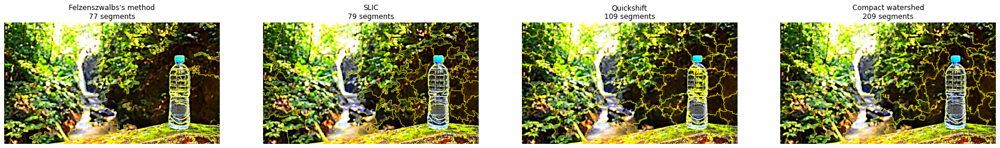

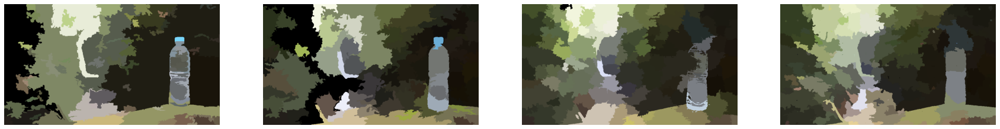

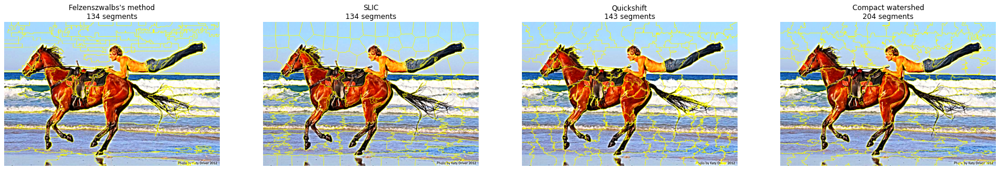

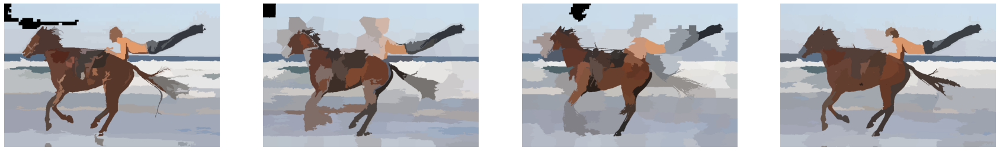

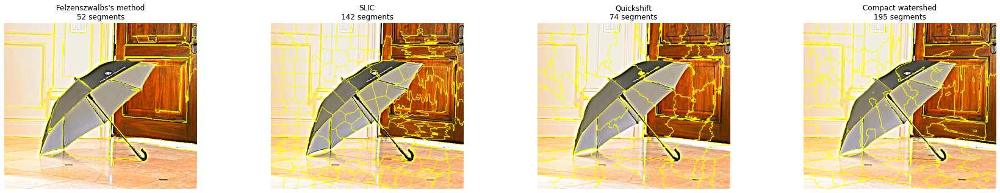

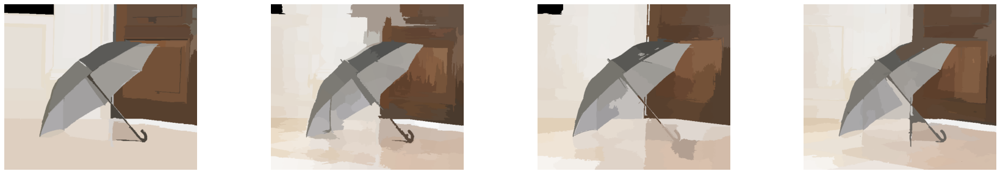

In [33]:
sharpQ3ClassicSegs=Calculate_Classic_Segmentations(sharpQ3Images, fz_scale=1000, fz_sigma=0.5 ,fz_min_size=400,
                                    slic_n_segments=200, slic_compactness=10, slic_sigma=1,
                                    qs_kernel_size=7, qs_max_dist=300, qs_ratio=0.3,
                                    ws_markers=200, ws_compactness=0.0001)
sharpQ3ClassicSegs_AVG=Calculate_Classic_Segmentations_AVG(Q3Images,sharpQ3ClassicSegs)

Plot_ClassicSegs_and_AVG_Q5(sharpQ3Images,sharpQ3ClassicSegs,sharpQ3ClassicSegs_AVG)

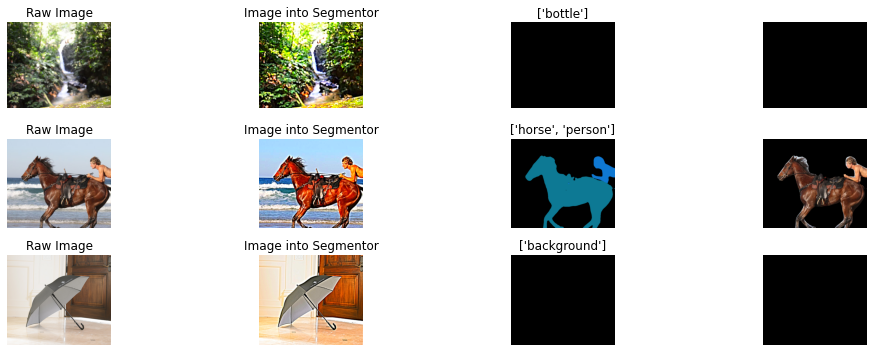

In [34]:
#Deep
sharpQ3Images_DeepSegGallery=PassForward2deeplabv3(Q3Images,sharpQ3Images)
plotDeepSegGalleries(sharpQ3Images_DeepSegGallery)

#SaveImages(sharpQ3Images_DeepSegGallery[1][1,3],names=['HorseHumanSharpen','HorseHumanSharpenMask'],dirname='Q5_Deep')

## Blur Images as preprocessing

In [35]:
def BlurImages(images,sigma=2):
  blur_images=[]
  for image in images:
    blur=skimage.filters.gaussian(np.array(image), sigma)
    blur_images.append(Image.fromarray((blur*255).astype(np.uint8)))

  return blur_images

C:\Users\alons\Miniconda2\envs\torch046746\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: Images with dimensions (M, N, 3) are interpreted as 2D+RGB by default. Use `multichannel=False` to interpret as 3D image with last dimension of length 3.
  after removing the cwd from sys.path.


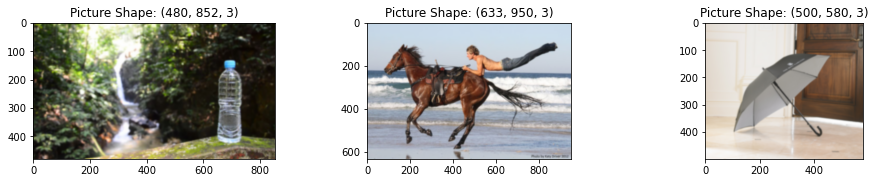

In [36]:
BlurQ3Images=BlurImages(Q3Images)
PlotImages(BlurQ3Images)

C:\Users\alons\Miniconda2\envs\torch046746\lib\site-packages\ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  


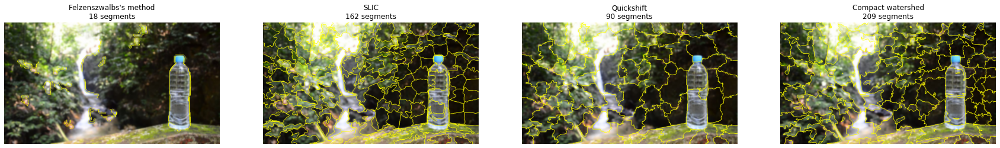

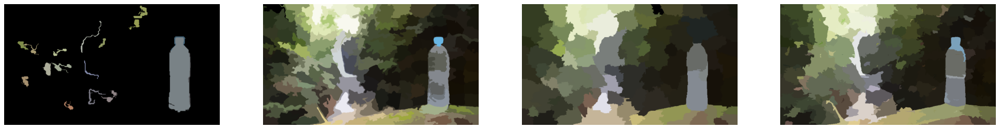

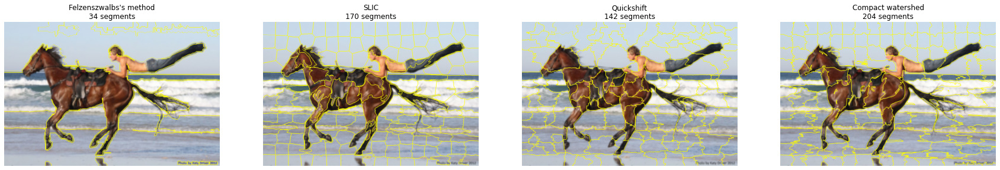

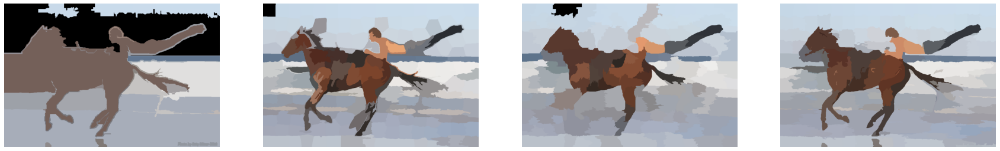

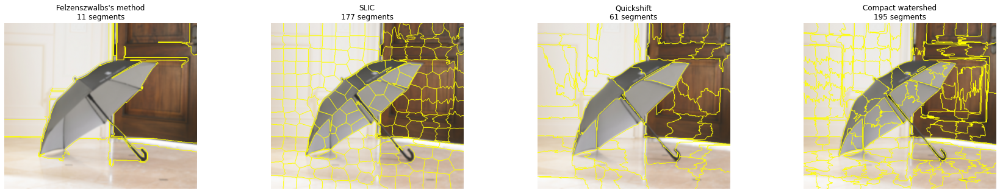

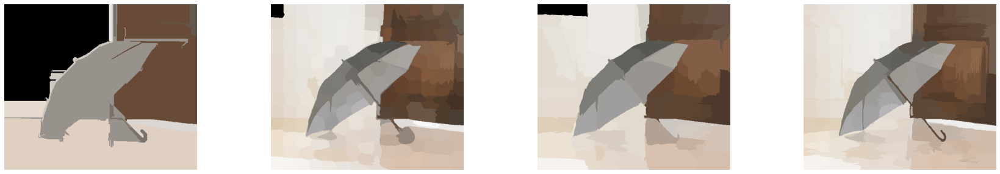

In [37]:
BlurQ3ClassicSegs=Calculate_Classic_Segmentations(BlurQ3Images, fz_scale=1000, fz_sigma=0.5 ,fz_min_size=400,
                                    slic_n_segments=200, slic_compactness=10, slic_sigma=1,
                                    qs_kernel_size=7, qs_max_dist=300, qs_ratio=0.3,
                                    ws_markers=200, ws_compactness=0.0001)
BlurQ3ClassicSegs_AVG=Calculate_Classic_Segmentations_AVG(BlurQ3Images,BlurQ3ClassicSegs)

Plot_ClassicSegs_and_AVG_Q5(BlurQ3Images,BlurQ3ClassicSegs,BlurQ3ClassicSegs_AVG)

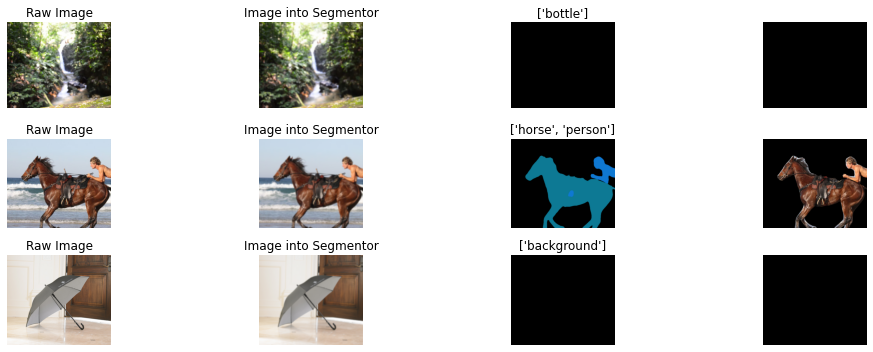

In [38]:
#Deep
BlurQ3Images_DeepSegGallery=PassForward2deeplabv3(Q3Images,BlurQ3Images)
plotDeepSegGalleries(BlurQ3Images_DeepSegGallery)

## Gamma Correction as PreProcessing

In [39]:
def GammaCorrectImages(images,gamma=1.5):
  gamma_corrected_images=[]
  for image in images:
    gamma_corrected_images.append(skimage.exposure.adjust_gamma(np.array(image), gamma))

  return gamma_corrected_images

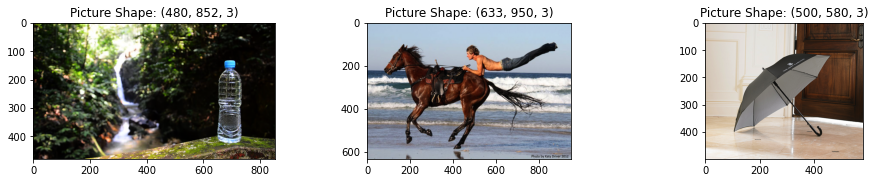

In [40]:
GammaQ3Images=GammaCorrectImages(Q3Images)
PlotImages(GammaQ3Images)

C:\Users\alons\Miniconda2\envs\torch046746\lib\site-packages\ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  


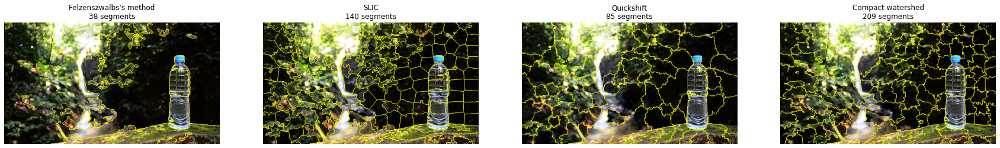

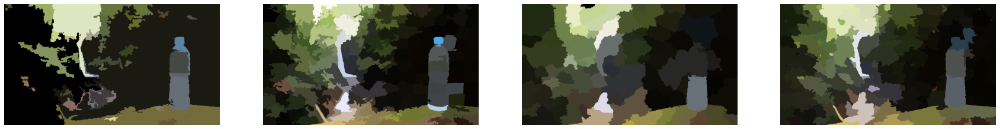

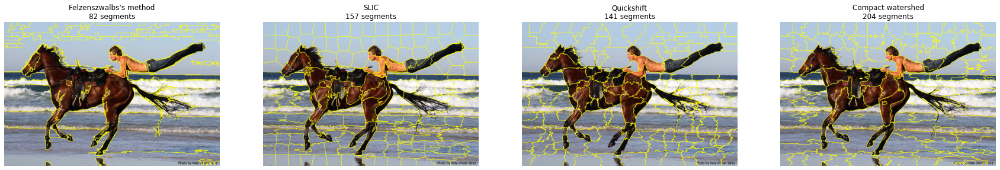

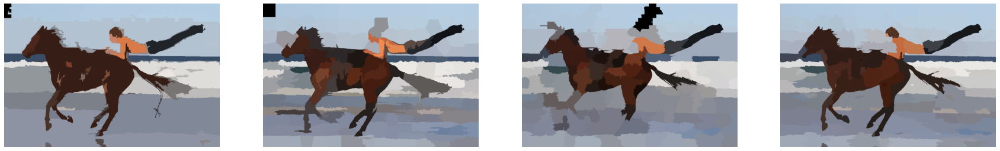

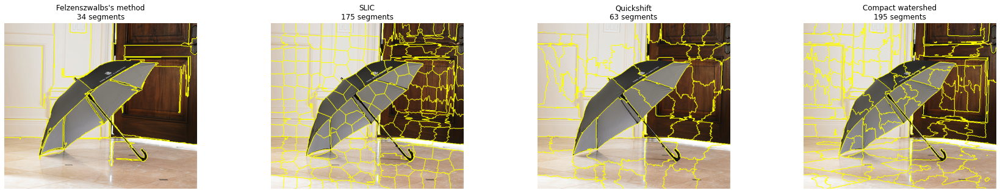

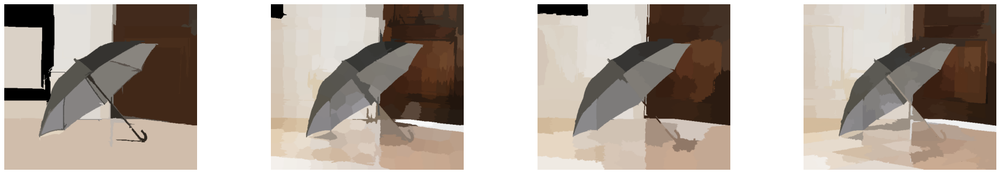

In [41]:
GammaQ3ClassicSegs=Calculate_Classic_Segmentations(GammaQ3Images, fz_scale=1000, fz_sigma=0.5 ,fz_min_size=400,
                                    slic_n_segments=200, slic_compactness=10, slic_sigma=1,
                                    qs_kernel_size=7, qs_max_dist=300, qs_ratio=0.3,
                                    ws_markers=200, ws_compactness=0.0001)
GammaQ3ClassicSegs_AVG=Calculate_Classic_Segmentations_AVG(GammaQ3Images,GammaQ3ClassicSegs)

Plot_ClassicSegs_and_AVG_Q5(GammaQ3Images,GammaQ3ClassicSegs,GammaQ3ClassicSegs_AVG)

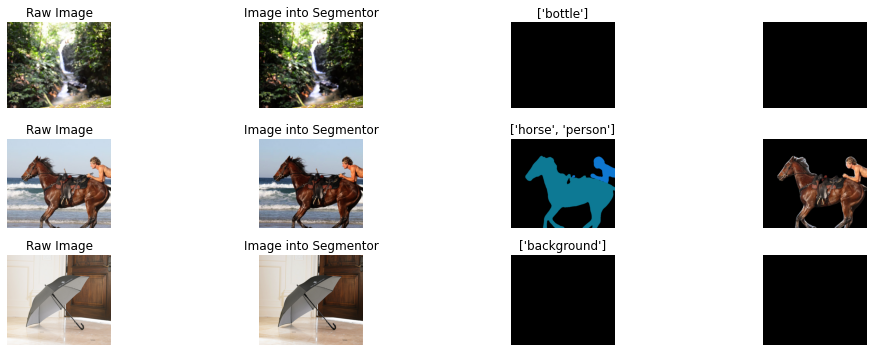

In [43]:
#Deep
GammaQ3Images_DeepSegGallery=PassForward2deeplabv3(Q3Images,GammaQ3Images)
plotDeepSegGalleries(GammaQ3Images_DeepSegGallery)

## Gamma + Blur as pre-processing

C:\Users\alons\Miniconda2\envs\torch046746\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: Images with dimensions (M, N, 3) are interpreted as 2D+RGB by default. Use `multichannel=False` to interpret as 3D image with last dimension of length 3.
  after removing the cwd from sys.path.


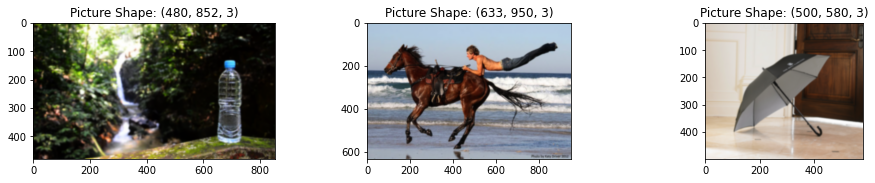

In [44]:
BlurGammaQ3Images=BlurImages(GammaCorrectImages(Q3Images))
PlotImages(BlurGammaQ3Images)

C:\Users\alons\Miniconda2\envs\torch046746\lib\site-packages\ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  


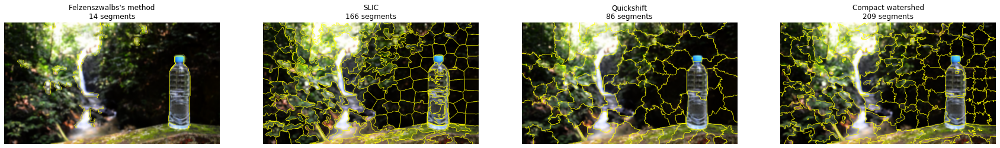

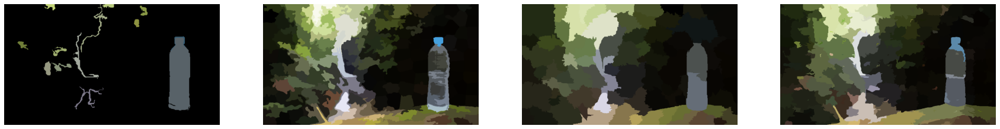

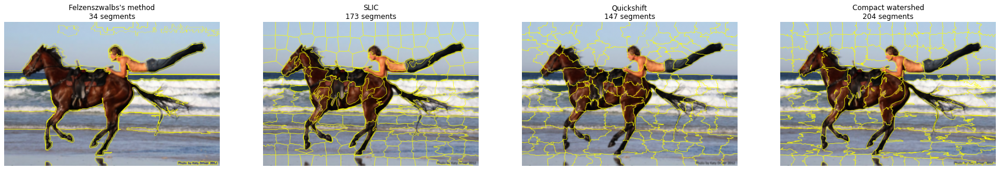

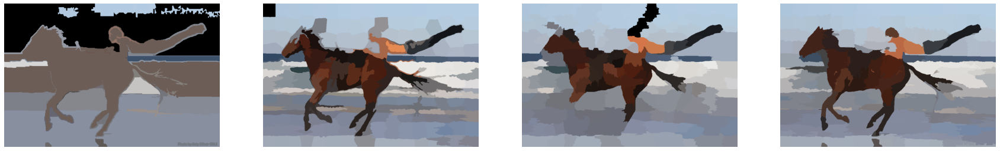

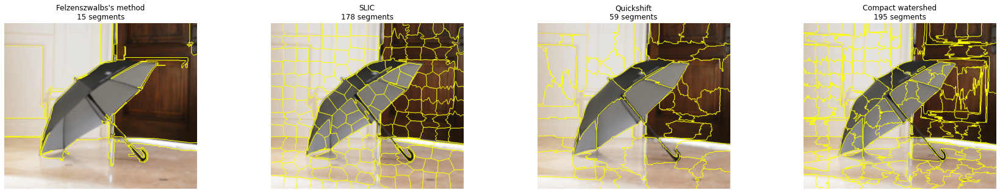

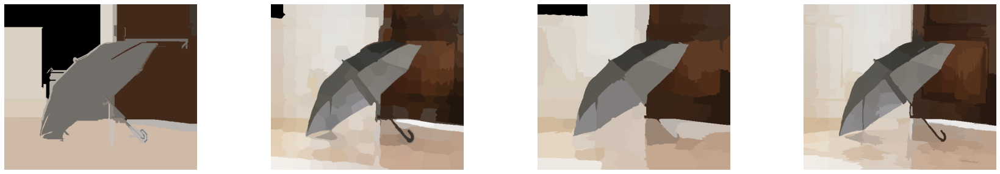

In [45]:
BlurGammaQ3ClassicSegs=Calculate_Classic_Segmentations(BlurGammaQ3Images, fz_scale=1000, fz_sigma=0.5 ,fz_min_size=400,
                                    slic_n_segments=200, slic_compactness=10, slic_sigma=1,
                                    qs_kernel_size=7, qs_max_dist=300, qs_ratio=0.3,
                                    ws_markers=200, ws_compactness=0.0001)
BlurGammaQ3ClassicSegs_AVG=Calculate_Classic_Segmentations_AVG(BlurGammaQ3Images,BlurGammaQ3ClassicSegs)

Plot_ClassicSegs_and_AVG_Q5(BlurGammaQ3Images,BlurGammaQ3ClassicSegs,BlurGammaQ3ClassicSegs_AVG)

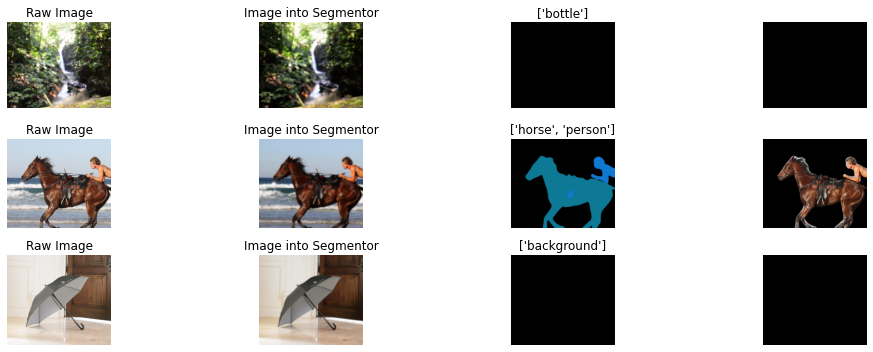

In [46]:
#Deep
BlurGammaQ3Images_DeepSegGallery=PassForward2deeplabv3(Q3Images,BlurGammaQ3Images)
plotDeepSegGalleries(BlurGammaQ3Images_DeepSegGallery)

## Compare Deep

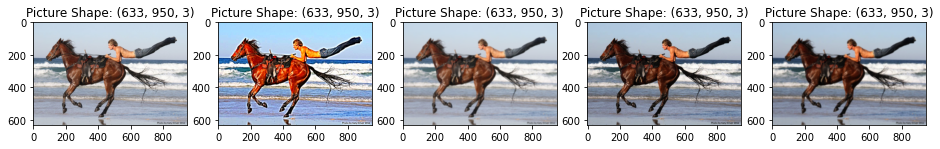

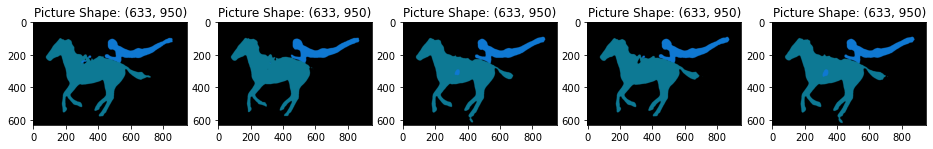

In [47]:
Q5_CompareDeep_input=[
Q3Images_DeepSegGallery[1][1],
sharpQ3Images_DeepSegGallery[1][1],
BlurQ3Images_DeepSegGallery[1][1],
GammaQ3Images_DeepSegGallery[1][1],
BlurGammaQ3Images_DeepSegGallery[1][1],
]

Q5_CompareDeep_seg=[
Q3Images_DeepSegGallery[1][2],
sharpQ3Images_DeepSegGallery[1][2],
BlurQ3Images_DeepSegGallery[1][2],
GammaQ3Images_DeepSegGallery[1][2],
BlurGammaQ3Images_DeepSegGallery[1][2],
]

PlotImages(Q5_CompareDeep_input)
PlotImages(Q5_CompareDeep_seg)

# Q6
Load a pre-trained classiﬁer (which was trained on ImageNet) from: https://pytorch.org/docs/stable/torchvision/models.html#classiﬁcation (https://pytorch.org/docs/stable/torchvision/models.html#classiﬁcation). In the previous assignment you used VGG16, but you can choose a different one for this assignment.

In [59]:
model2 = torchvision.models.resnet152(pretrained=True).to(device)
model2 = model2.to(device)
model2.eval();

with open(RelPath+'/data/imagenet1000_clsidx_to_labels.txt', 'r') as f:
    class_id_to_key = [line for line in f.readlines()]

#Q7
Pick an image of an animal in its natural habitat (e.g., cow on grass ﬁelds, zebra in the safari, ...). Display the image you chose and feedforward it to the pre-trained network. What is the network's prediction? To convert from class index to label, use the supplied ./data/imagenet1000_clsidx_to_labels.txt ﬁle. You can also use the supplied ./data/cow.jpg or ./data/sheep.jpg.

## functions

In [60]:
def fit2resnet152(images,device):
    preprocess = transforms.Compose([  
        transforms.Resize((224)),
        transforms.ToTensor(),   #also converts imaget to 0-1 instead of 0-255. tested and verified by **
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225])
        ])
    
    transformed_images=[]
    for im in images:
        t_im = preprocess(im).unsqueeze(0).to(device) #unsqueeze makes the size [1,3,W,H]
        transformed_images.append(t_im)
    return transformed_images #cant use tensor.stack() because images may not be of the same size!!
    
    #**https://discuss.pytorch.org/t/why-does-transforms-totensor-convert-the-range-to-0-1/26095
    #https://pytorch.org/docs/stable/torchvision/models.html#classi%EF%AC%81cation

In [61]:
def predict(images, model, class_id_to_key):
    predictions=[]
    for image in images:
        _, index = model(image).data[0].max(0)
        class_id = index.item()
        class_name = class_id_to_key[class_id]
        predictions.append((class_id,class_name))
    return predictions

In [62]:
def plot_predictions(images,predictions,device):
    #images before preprocess!
    fig,axes = plt.subplots(1,len(images),figsize = (16,2.5))
    for idx,image in enumerate(images):
        axes[idx].imshow(image)
        axes[idx].set_title("class {}\n{}".format(predictions[idx][0],predictions[idx][1]))
        axes[idx].axis('off')

## Results

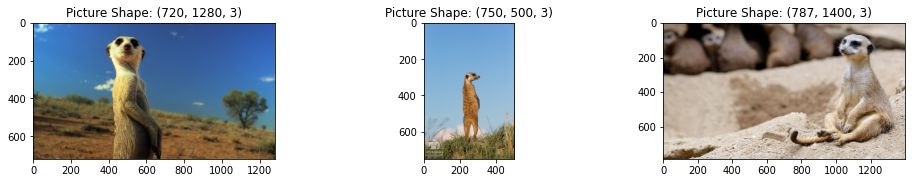

In [63]:
Q7ImagesMeerKat=ImageImport(RelPath+'/my_data/Part1Q7/MeerKats')
PlotImages(Q7ImagesMeerKat)

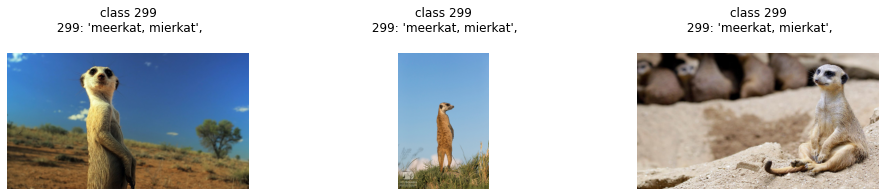

In [64]:
Q7ImagesMeerKat_resnet=fit2resnet152(Q7ImagesMeerKat,device)
predictions=predict(Q7ImagesMeerKat_resnet, model2, class_id_to_key)
plot_predictions(Q7ImagesMeerKat,predictions,device)

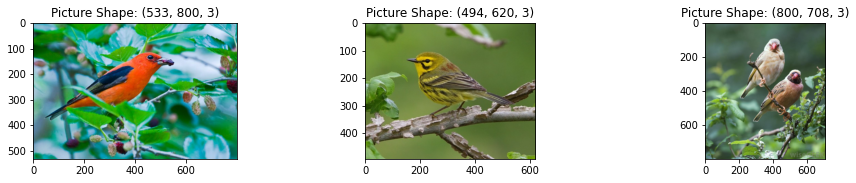

In [78]:
Q7ImagesBird=ImageImport(RelPath+'/my_data/Part1Q7/Birds')
PlotImages(Q7ImagesBird)

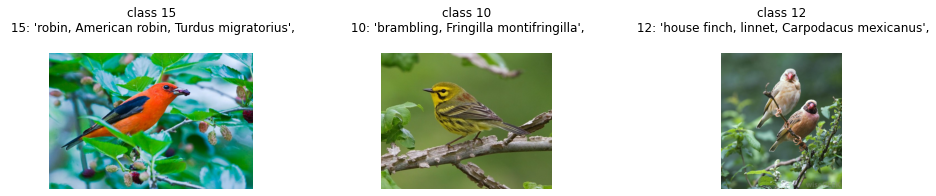

In [79]:
Q7ImagesBird_resnet=fit2resnet152(Q7ImagesBird,device)
predictions=predict(Q7ImagesBird_resnet, model2, class_id_to_key)
plot_predictions(Q7ImagesBird,predictions,device)

#Q8 
Segement the animal using one of the methods (classic or deep) and display the result.

## Classic

C:\Users\orene\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  


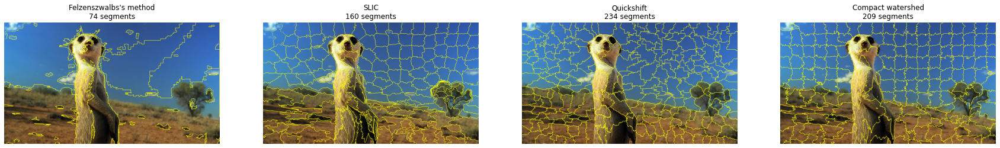

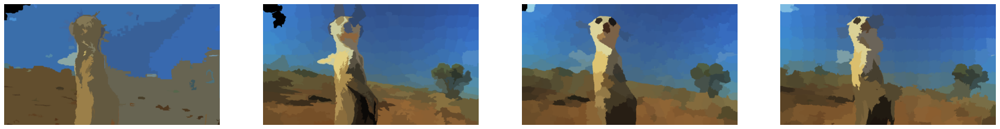

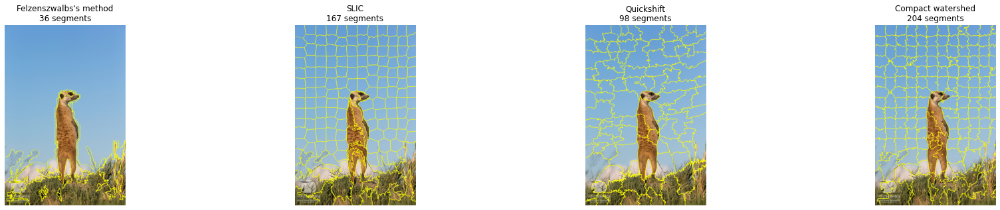

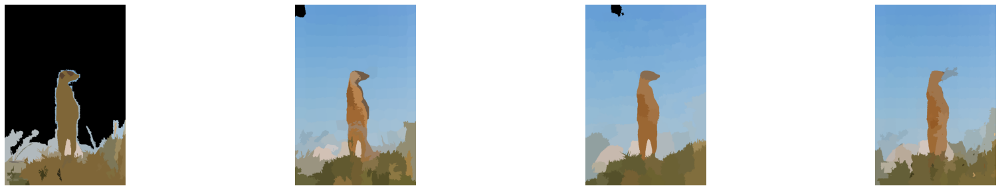

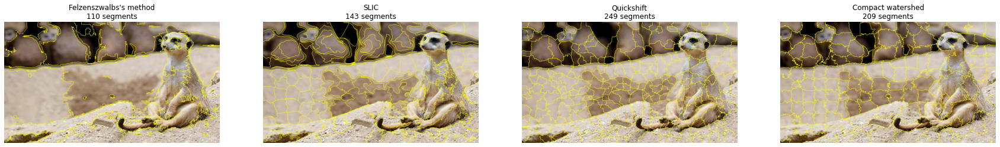

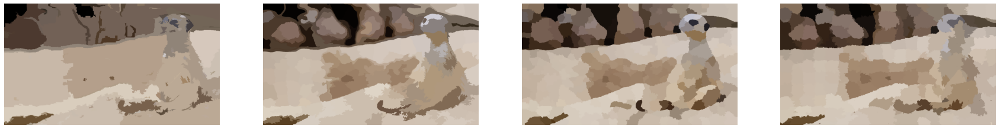

In [67]:
Q7ImagesMeerKatClassicSegs=Calculate_Classic_Segmentations(Q7ImagesMeerKat, fz_scale=600, fz_sigma=0.5 ,fz_min_size=200,
                                    slic_n_segments=200, slic_compactness=5, slic_sigma=1,
                                    qs_kernel_size=7, qs_max_dist=150, qs_ratio=0.3,
                                    ws_markers=200, ws_compactness=0.0001)
Q7ImagesMeerKatClassicSegs_AVG=Calculate_Classic_Segmentations_AVG(Q7ImagesMeerKat,Q7ImagesMeerKatClassicSegs)

Plot_ClassicSegs_and_AVG_Q5(Q7ImagesMeerKat,Q7ImagesMeerKatClassicSegs,Q7ImagesMeerKatClassicSegs_AVG)

In [68]:
Q7ImagesBirdClassicSegs=Calculate_Classic_Segmentations(Q7ImagesBird)
Q7ImagesBirdClassicSegs_AVG=Calculate_Classic_Segmentations_AVG(Q7ImagesBird,Q7ImagesBirdClassicSegs)

Plot_ClassicSegs_and_AVG_Q5(Q7ImagesBird,Q7ImagesBirdClassicSegs,Q7ImagesBirdClassicSegs_AVG)

## Deep

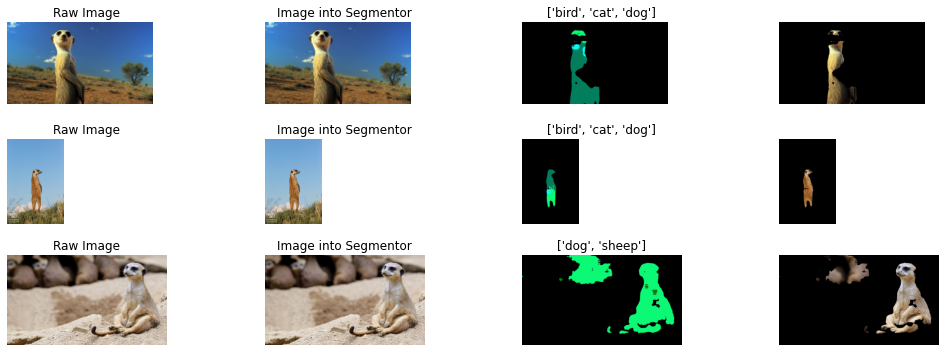

In [69]:
Q7ImagesMeerKat_DeepSegGallery=PassForward2deeplabv3(Q7ImagesMeerKat,Q7ImagesMeerKat)
plotDeepSegGalleries(Q7ImagesMeerKat_DeepSegGallery)

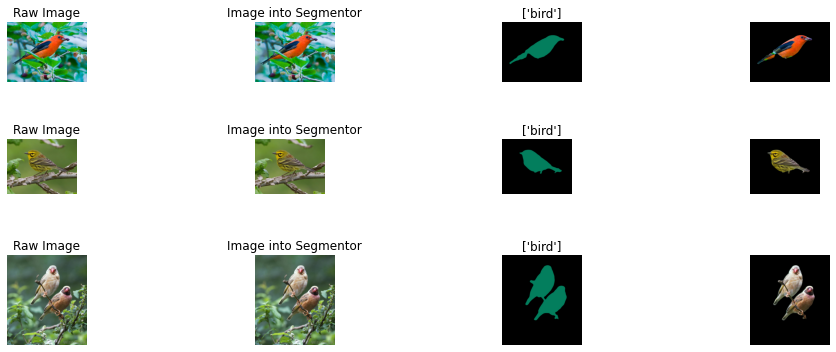

In [80]:
Q7ImagesBird_DeepSegGallery=PassForward2deeplabv3(Q7ImagesBird,Q7ImagesBird)
plotDeepSegGalleries(Q7ImagesBird_DeepSegGallery)

#Q9
Put the the animal in a different habitat, i.e., use the mask to place the animal on a different background. You can choose any background you want (which is not the animal's natural habitat). For example, put the cow on a beach (./data/beach.jpg for example) or the elaphant/sheep in a room (./data/room.jpg for example). Display the result.

## Functions

In [81]:
def transparent(mask_image):
    img = mask_image.convert("RGBA")
    datas = img.getdata()

    newData = []
    for item in datas:
        if item[0] == 0 and item[1] == 0 and item[2] == 0:
            newData.append((255, 255, 255, 0))
        else:
            newData.append(item)
    img.putdata(newData)
    return img

def pasteIm2ONim1(im1,im2,initial_pos):
  copy = im1.copy()
  copy.paste(im2,initial_pos,im2)
  return copy

def MeshImages(base_im,over_im,initial_pos,maxsize_over_im):
  copy_over_im=over_im.copy()
  copy_over_im=transparent(copy_over_im)
  copy_over_im.thumbnail((maxsize_over_im,maxsize_over_im))
  MeshImage=pasteIm2ONim1(base_im,copy_over_im,initial_pos)
  return MeshImage

## My Backgrounds

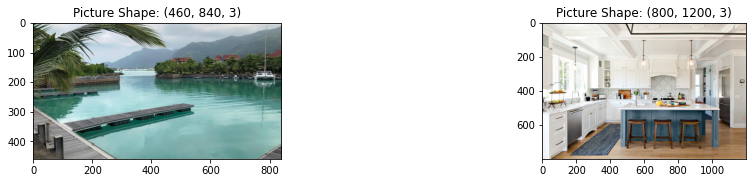

In [82]:
Q9MyImages=ImageImport(RelPath+'/my_data/Part1Q9')
PlotImages(Q9MyImages)

KitchenImage=Q9MyImages[0]
DockImage=Q9MyImages[1]

### Kitchen Images

In [83]:
BirdKitchenMesh=[0]*3 #initalize

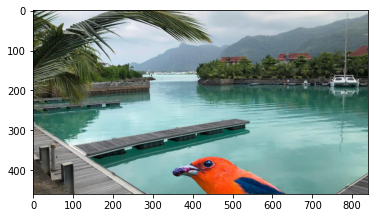

In [84]:
over_im=Q7ImagesBird_DeepSegGallery[0][3]

Mesh1=MeshImages(KitchenImage,over_im,(600,250),800)
over_im_t = over_im.transpose(Image.FLIP_LEFT_RIGHT)
Mesh2=MeshImages(Mesh1,over_im_t,(100,250),800)

BirdKitchenMesh[0]=Mesh2
plt.imshow(BirdKitchenMesh[0])

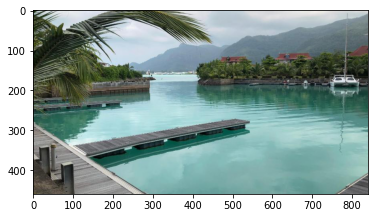

In [85]:
over_im=Q7ImagesBird_DeepSegGallery[1][3]

BirdKitchenMesh[1]=MeshImages(KitchenImage,over_im,(0,500),500)
plt.imshow(BirdKitchenMesh[1])

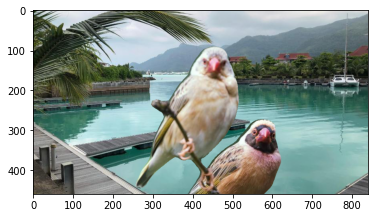

In [86]:
over_im=Q7ImagesBird_DeepSegGallery[2][3]

BirdKitchenMesh[2]=MeshImages(KitchenImage,over_im,(50,0),800)
plt.imshow(BirdKitchenMesh[2])

### Dock Images

In [87]:
BirdDockMesh=[0]*3 #initalize

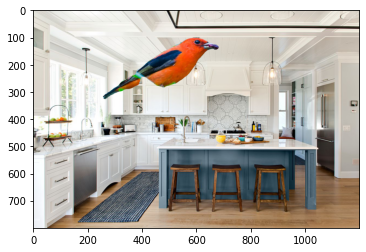

In [88]:
over_im=Q7ImagesBird_DeepSegGallery[0][3]

BirdDockMesh[0]=MeshImages(DockImage,over_im,(200,0),700)
plt.imshow(BirdDockMesh[0])

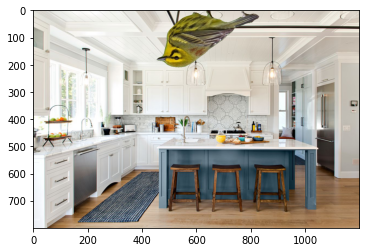

In [89]:
over_im=Q7ImagesBird_DeepSegGallery[1][3]
over_im_t = over_im.transpose(Image.FLIP_TOP_BOTTOM)

BirdDockMesh[1]=MeshImages(DockImage,over_im_t,(300,-180),700)
plt.imshow(BirdDockMesh[1])

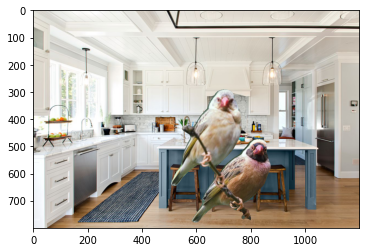

In [90]:
over_im=Q7ImagesBird_DeepSegGallery[2][3]

BirdDockMesh[2]=MeshImages(DockImage,over_im,(300,200),800)
plt.imshow(BirdDockMesh[2])

### Given Backgrounds

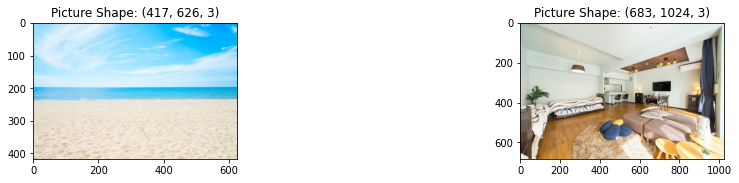

In [91]:
BeachImage=Image.open(RelPath+'/data/beach.jpg')
RoomImage=Image.open(RelPath+'/data/room.jpg')
PlotImages([BeachImage,RoomImage])

### Beach Background

In [92]:
BirdBeachMesh=[0]*3 #initalize

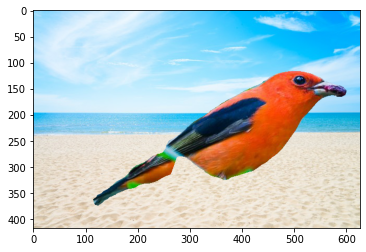

In [93]:
over_im=Q7ImagesBird_DeepSegGallery[0][3]

BirdBeachMesh[0]=MeshImages(BeachImage,over_im,(50,0),800)
plt.imshow(BirdBeachMesh[0])

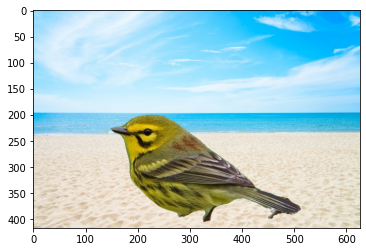

In [94]:
over_im=Q7ImagesBird_DeepSegGallery[1][3]

BirdBeachMesh[1]=MeshImages(BeachImage,over_im,(0,100),600)
plt.imshow(BirdBeachMesh[1])

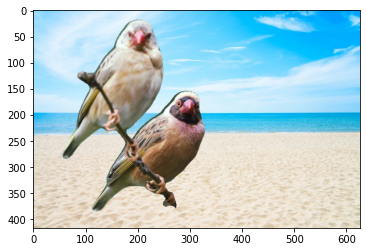

In [95]:
over_im=Q7ImagesBird_DeepSegGallery[2][3]

BirdBeachMesh[2]=MeshImages(BeachImage,over_im,(-100,-50),600)
plt.imshow(BirdBeachMesh[2])

### Room Background

In [96]:
BirdRoomMesh=[0]*3 #initalize

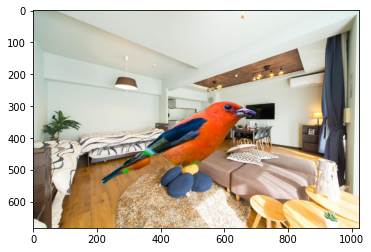

In [97]:
over_im=Q7ImagesBird_DeepSegGallery[0][3]

BirdRoomMesh[0]=MeshImages(RoomImage,over_im,(150,170),800)
plt.imshow(BirdRoomMesh[0])

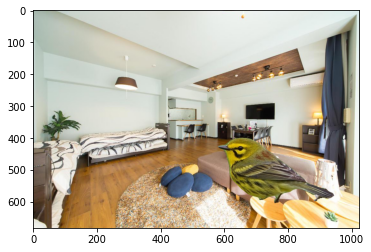

In [98]:
over_im=Q7ImagesBird_DeepSegGallery[1][3]

BirdRoomMesh[1]=MeshImages(RoomImage,over_im,(430,300),600)
plt.imshow(BirdRoomMesh[1])

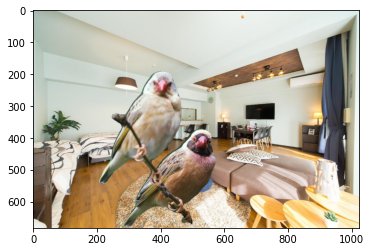

In [99]:
over_im=Q7ImagesBird_DeepSegGallery[2][3]
BirdRoomMesh[2]=MeshImages(RoomImage,over_im,(0,100),800)
plt.imshow(BirdRoomMesh[2])

## Save Mesh Images

In [100]:
birdnames=['bird1','bird2','bird3']

In [108]:
# KitcenBirdNames=['kitchen_' + birdname for birdname in birdnames]
# SaveImages(BirdKitchenMesh,KitcenBirdNames,'Q9/Kitchen')

# DockBirdNames=['dock_' + birdname for birdname in birdnames]
# SaveImages(BirdDockMesh,DockBirdNames,'Q9/Dock')

# BeachBirdNames=['beach_' + birdname for birdname in birdnames]
# SaveImages(BirdBeachMesh,BeachBirdNames,'Q9/Beach')

# RoomBirdNames=['room_' + birdname for birdname in birdnames]
# SaveImages(BirdRoomMesh,RoomBirdNames,'Q9/Room')

#Q10
Feed forward the the new image (e.g. the sheep in the room) to the pre-trained network. Was the prediction different than Q7? If so, discuss the reasons for that to happend

## Results

In [102]:
def predictQ10(images, model, class_id_to_key):
    predictions=[]
    for image in images:
        out=model(image).data[0]
        classifier_results= out.argsort(descending=True)
        
        index1=classifier_results[0]
        class_name1 = class_id_to_key[index1]

        index2=classifier_results[1]
        class_name2 = class_id_to_key[index2]

        index3=classifier_results[2]
        class_name3 = class_id_to_key[index3]


        predictions.append((index1,class_name1,index2,class_name2,index3,class_name3))
    return predictions

def plot_predictionsQ10(images,predictions,device):
  #images before preprocess!
  fig,axes = plt.subplots(1,len(images),figsize = (16,2.5))
  for idx,image in enumerate(images):
    axes[idx].imshow(image)
    axes[idx].set_title("class {}\n{}\nclass {}\n{}\nclass {}\n{}".format(predictions[idx][0],predictions[idx][1],
                                                            predictions[idx][2],predictions[idx][3],
                                                            predictions[idx][4],predictions[idx][5]))
    axes[idx].axis('off')

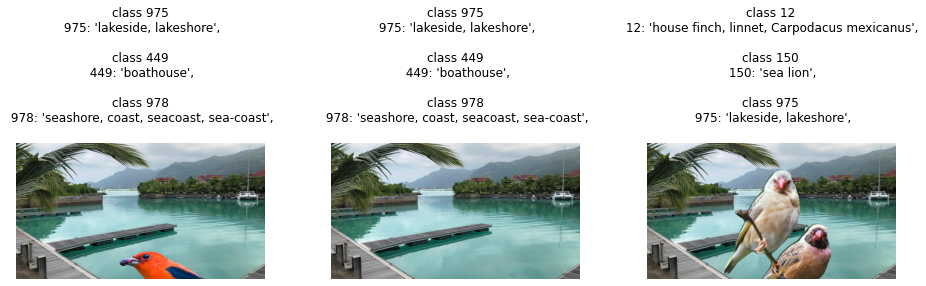

In [103]:
BirdKitchenMesh_resnet=fit2resnet152(BirdKitchenMesh,device)
predictions=predictQ10(BirdKitchenMesh_resnet, model2, class_id_to_key)
plot_predictionsQ10(BirdKitchenMesh,predictions,device)

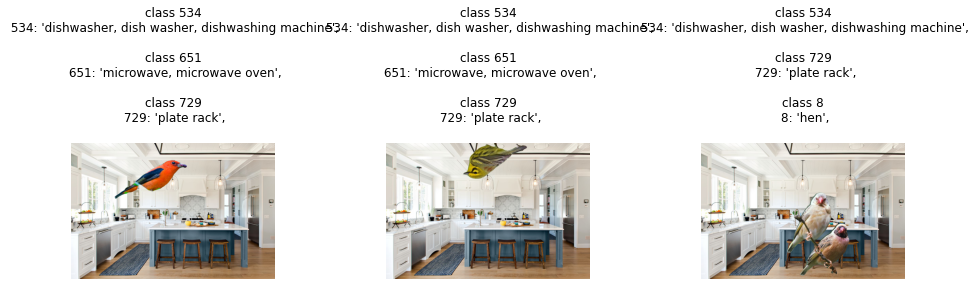

In [104]:
BirdDockMesh_resnet=fit2resnet152(BirdDockMesh,device)
predictions=predictQ10(BirdDockMesh_resnet, model2, class_id_to_key)
plot_predictionsQ10(BirdDockMesh,predictions,device)

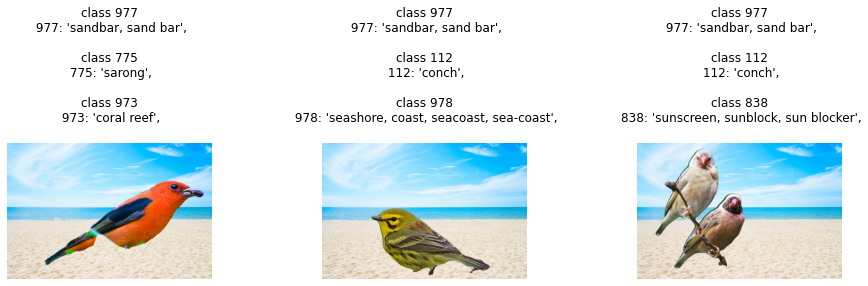

In [105]:
BirdBeachMesh_resnet=fit2resnet152(BirdBeachMesh,device)
predictions=predictQ10(BirdBeachMesh_resnet, model2, class_id_to_key)
plot_predictionsQ10(BirdBeachMesh,predictions,device)

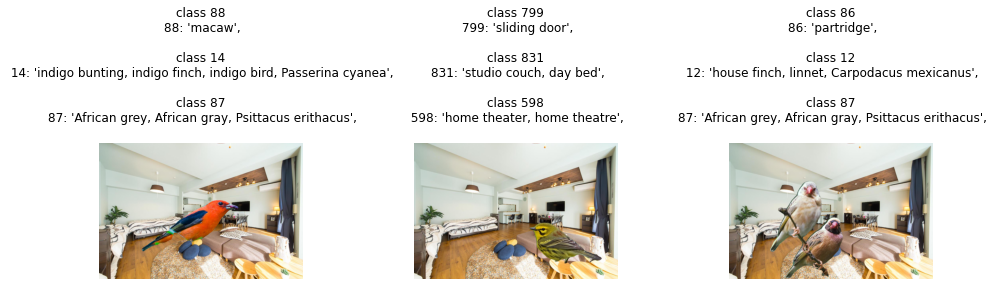

In [106]:
BirdRoomMesh_resnet=fit2resnet152(BirdRoomMesh,device)
predictions=predictQ10(BirdRoomMesh_resnet, model2, class_id_to_key)
plot_predictionsQ10(BirdRoomMesh,predictions,device)